In [1]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
!pip install adtk

In [236]:
#Importamos las librerias
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import glob, os
import plotly.express as px #para detectar outliers de forma grafica
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

# Librerias para los modelos
from sklearn.cluster import KMeans
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_validate
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.neighbors import LocalOutlierFactor
from sklearn.preprocessing import StandardScaler

from adtk.detector import InterQuartileRangeAD
from adtk.visualization import plot

##1. Carga de los datos

In [3]:
#Cargando google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Carga de datos de archivo de clientes .csv
files = glob.glob('/content/drive/MyDrive/05. Uniandes/08. Ciclo 08/01. Proyecto Aplicado/01. Datos/*.csv')
dfIC= pd.concat([pd.read_csv(fp).assign(Clientes=os.path.basename(fp)) for fp in files])

# Carga de datos de archivo de sector economico .csv
dfSE = pd.read_csv('/content/drive/MyDrive/05. Uniandes/08. Ciclo 08/01. Proyecto Aplicado/01. Datos/Sector Economico/sector_economico_clientes.csv', sep=';', encoding = "utf-8")

In [5]:
# normalizar fecha
#dfIC["Fecha"] = dfIC["Fecha"].str.split().str[0]
#dfIC["Fecha"]=pd.to_datetime(dfIC["Fecha"]).dt.normalize()
dfIC["Fecha"] = pd.to_datetime(dfIC['Fecha'], errors='coerce')

In [6]:
dfIC.describe()

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC
count,463425,463425.000000,463425.000000,463425.000000,463425.000000
mean,2021-12-14 21:01:37.141932800,1.472050,0.873086,1420.188470,1438.515836
min,2021-01-01 00:00:00,-1.329018,0.000000,0.031000,0.031000
25%,2021-06-10 21:00:00,0.242788,0.112832,719.462874,748.148254
50%,2021-11-18 19:00:00,0.810771,0.380650,1625.493463,1634.696089
75%,2022-05-30 03:00:00,1.992488,1.222834,2037.276385,2040.554497
max,2023-04-01 00:00:00,14.622644,11.135141,4266.229746,4399.038932
std,NaN,1.718780,1.158846,766.299118,746.447449


In [7]:
# Organizar la columna de clientes
dfIC['Clientes'] = dfIC['Clientes'].str.split('.').str[0]
dfIC['Clientes'] = dfIC['Clientes'].str.split('OS').str[1]

In [8]:
# Convertimos la columna clientes a mayuscula
dfSE['Clientes'] = dfSE['Clientes'].str.upper()

In [9]:
# Renombramos la columna sector economico
dfSE.rename(columns={'Sector Economico': 'Sector'}, inplace=True)

In [10]:
# Unimos los dataframe
df=pd.merge(dfIC, dfSE, on=["Clientes", "Clientes"])

In [11]:
df.head()

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector
0,2021-01-01 00:00:00,2.873046,0.508548,1557.057893,1312.106981,CLIENTE10,Cultivo de Árboles Frutales y Nueces
1,2021-01-01 01:00:00,2.037791,0.532105,1456.095693,1329.850730,CLIENTE10,Cultivo de Árboles Frutales y Nueces
2,2021-01-01 02:00:00,2.358945,0.797515,1226.481132,1301.578937,CLIENTE10,Cultivo de Árboles Frutales y Nueces
3,2021-01-01 03:00:00,1.347161,0.472839,1138.403031,1379.538878,CLIENTE10,Cultivo de Árboles Frutales y Nueces
4,2021-01-01 04:00:00,2.486699,0.488362,1062.467048,1594.077359,CLIENTE10,Cultivo de Árboles Frutales y Nueces


In [12]:
# Creamos una columna con el voltaje promedio de fase a y fase c
df['Voltaje_Promedio'] = (df['Voltaje_FA'] + df['Voltaje_FC'])/2

In [13]:
# Creamos el campo de energia absorbida
df['Energia_Absorbida'] = (df['Active_energy'] + df['Reactive_energy'])

In [14]:
# Adicionamos columnas por ano y mes
df["Year"] = (df["Fecha"].dt.year.astype(str))
df["Month"] = (df["Fecha"].dt.month.astype(str))
df["Day"] = (df["Fecha"].dt.day.astype(str))
df["Time"] = (df["Fecha"].dt.time.astype(str))

## 2. Entendimiento de los datos

In [15]:
# Entendemos el set de datos
df.describe(include='all')

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Year,Month,Day,Time
count,463425,463425.000000,463425.000000,463425.000000,463425.000000,463425,463425,463425.000000,463425.000000,463425,463425,463425,463425
unique,NaN,NaN,NaN,NaN,NaN,30,7,NaN,NaN,3,12,31,24
top,NaN,NaN,NaN,NaN,NaN,CLIENTE10,Cultivo de Árboles Frutales y Nueces,NaN,NaN,2021,1,1,00:00:00
freq,NaN,NaN,NaN,NaN,NaN,19681,98405,NaN,NaN,262800,52905,15514,19327
mean,2021-12-14 21:01:37.141932800,1.472050,0.873086,1420.188470,1438.515836,NaN,NaN,1429.352153,2.345136,NaN,NaN,NaN,NaN
min,2021-01-01 00:00:00,-1.329018,0.000000,0.031000,0.031000,NaN,NaN,0.031000,-1.129018,NaN,NaN,NaN,NaN
25%,2021-06-10 21:00:00,0.242788,0.112832,719.462874,748.148254,NaN,NaN,720.045602,0.494082,NaN,NaN,NaN,NaN
50%,2021-11-18 19:00:00,0.810771,0.380650,1625.493463,1634.696089,NaN,NaN,1639.040154,1.325284,NaN,NaN,NaN,NaN
75%,2022-05-30 03:00:00,1.992488,1.222834,2037.276385,2040.554497,NaN,NaN,2045.539304,3.279156,NaN,NaN,NaN,NaN
max,2023-04-01 00:00:00,14.622644,11.135141,4266.229746,4399.038932,NaN,NaN,4011.195263,22.023913,NaN,NaN,NaN,NaN


In [16]:
# Consultar datos
df.head()

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Year,Month,Day,Time
0,2021-01-01 00:00:00,2.873046,0.508548,1557.057893,1312.106981,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1434.582437,3.381594,2021,1,1,00:00:00
1,2021-01-01 01:00:00,2.037791,0.532105,1456.095693,1329.850730,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1392.973211,2.569896,2021,1,1,01:00:00
2,2021-01-01 02:00:00,2.358945,0.797515,1226.481132,1301.578937,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1264.030034,3.156459,2021,1,1,02:00:00
3,2021-01-01 03:00:00,1.347161,0.472839,1138.403031,1379.538878,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1258.970955,1.820001,2021,1,1,03:00:00
4,2021-01-01 04:00:00,2.486699,0.488362,1062.467048,1594.077359,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1328.272204,2.975061,2021,1,1,04:00:00


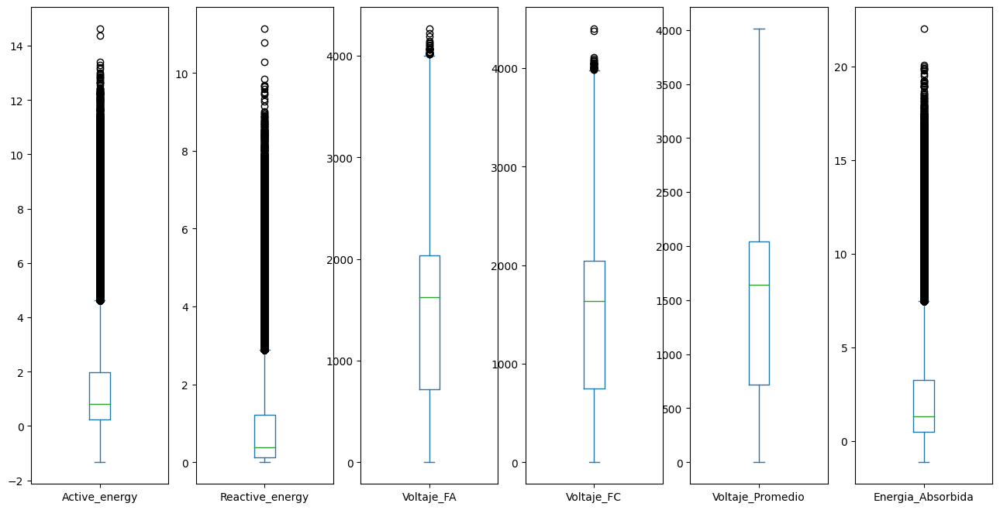

In [17]:
# Boxplot de las variables
axes = df.plot.box(figsize=(16, 8), subplots=True)

array([[<Axes: title={'center': 'Fecha'}>,
        <Axes: title={'center': 'Active_energy'}>,
        <Axes: title={'center': 'Reactive_energy'}>],
       [<Axes: title={'center': 'Voltaje_FA'}>,
        <Axes: title={'center': 'Voltaje_FC'}>,
        <Axes: title={'center': 'Voltaje_Promedio'}>],
       [<Axes: title={'center': 'Energia_Absorbida'}>, <Axes: >,
        <Axes: >]], dtype=object)

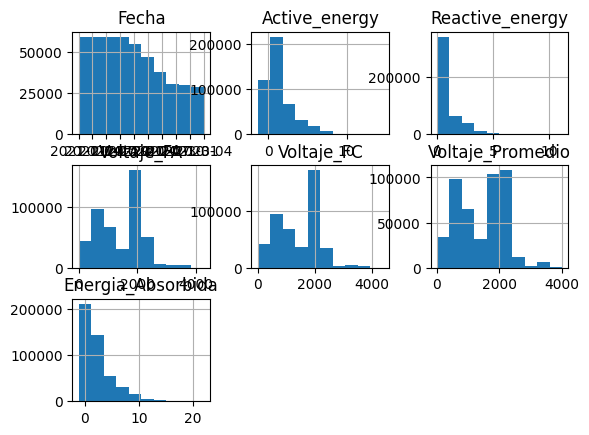

In [18]:
# Realizamos histograma por sector
df.drop(['Sector'],axis= 1).hist()

array([[<Axes: title={'center': 'Fecha'}>,
        <Axes: title={'center': 'Active_energy'}>,
        <Axes: title={'center': 'Reactive_energy'}>],
       [<Axes: title={'center': 'Voltaje_FA'}>,
        <Axes: title={'center': 'Voltaje_FC'}>,
        <Axes: title={'center': 'Voltaje_Promedio'}>],
       [<Axes: title={'center': 'Energia_Absorbida'}>, <Axes: >,
        <Axes: >]], dtype=object)

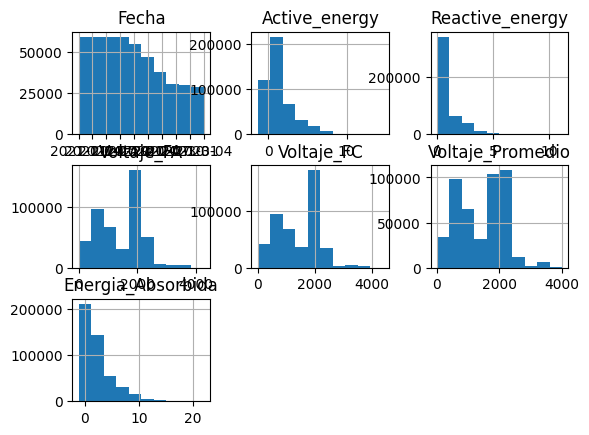

In [19]:
# Realizamos histograma por cliente
df.drop(['Clientes'],axis= 1).hist()

In [20]:
# entendemos comportamiento por ano
dfYear = df[['Year','Active_energy']]
dfYear.sort_values(['Year'], ascending=False).groupby(['Year'])['Active_energy'].mean()
#dfYear.groupby(['Year'])['Active_energy'].mean().sort_values(ascending=False)

Year
2021    1.301685
2022    1.780517
2023    1.237371
Name: Active_energy, dtype: float64

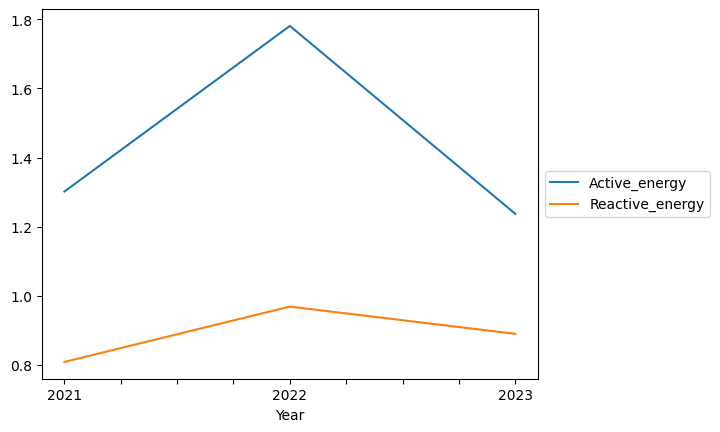

In [21]:
# Entendiendo informacion por year
dfp = df.pivot_table(index="Year" ,values=['Active_energy','Reactive_energy'],aggfunc={'Active_energy': 'mean', 'Reactive_energy':'mean'})
dfp.plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

### Sector

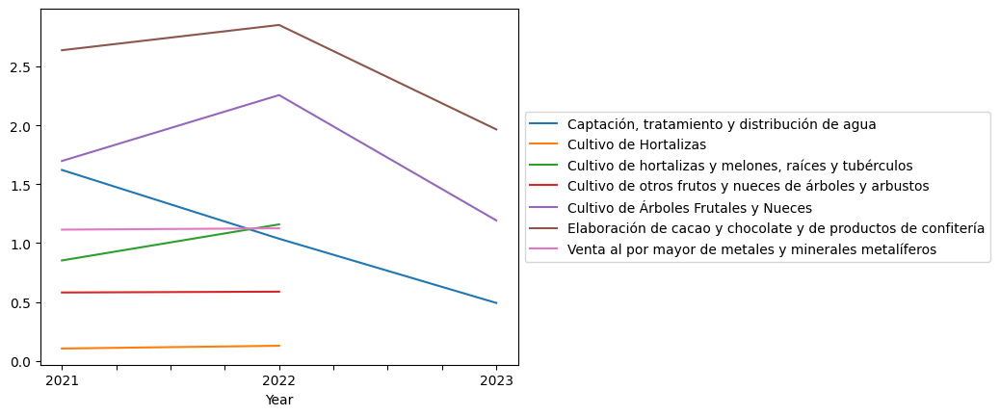

In [22]:
dfp = df.pivot_table(values="Active_energy", index="Year", columns="Sector", aggfunc={'Active_energy': 'mean'})
dfp.plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

In [23]:
# entendemos comportamiento por mes
dfMonth = df[['Month','Active_energy','Sector']]
dfMonth.sort_values(['Month'], ascending=False).groupby(['Month'])['Active_energy'].mean()
#df.sort_values(['job','count'],ascending=False).groupby('job').head(3)

Month
1     1.493154
10    1.550965
11    1.565312
12    1.575299
2     1.514608
3     1.560561
4     1.399587
5     1.304935
6     1.360839
7     1.295736
8     1.477703
9     1.541621
Name: Active_energy, dtype: float64

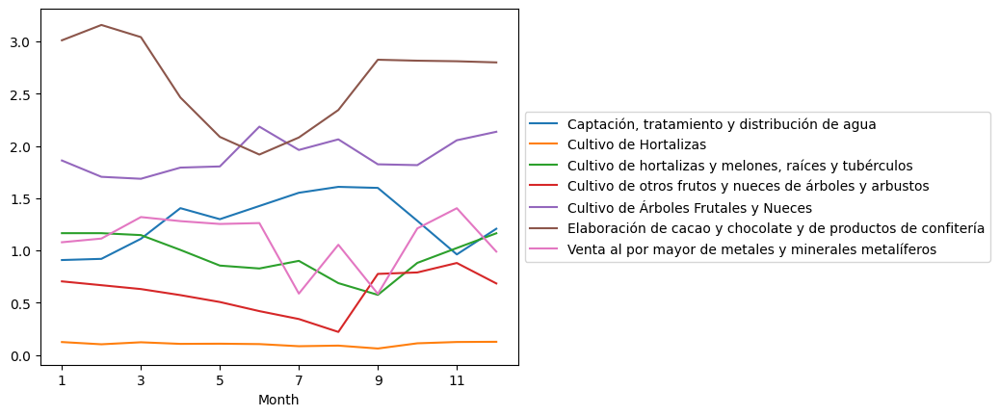

In [24]:
dfM = dfMonth.pivot_table(values="Active_energy", index="Month", columns="Sector",aggfunc={'Active_energy': 'mean'})
dfM.reindex(["1", "2", "3","4", "5","6","7","8","9","10","11","12"]).plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5))

In [25]:
dfSector = df[['Clientes','Active_energy']]
dfSector.groupby(['Clientes'])['Active_energy'].mean().sort_values(ascending=False).head(8)

Clientes
CLIENTE5     4.998897
CLIENTE10    3.545042
CLIENTE2     2.745060
CLIENTE7     2.426154
CLIENTE3     2.341707
CLIENTE1     1.940788
CLIENTE27    1.870751
CLIENTE8     1.579517
Name: Active_energy, dtype: float64

In [26]:
dfSector = df.pivot_table(index="Sector",values=['Active_energy','Reactive_energy'],aggfunc={'Active_energy': 'mean', 'Reactive_energy':'mean'})
print(dfSector)

                                                    Active_energy  \
Sector                                                              
Captación, tratamiento y distribución de agua            1.244150   
Cultivo de Hortalizas                                    0.105204   
Cultivo de hortalizas y melones, raíces y tubér...       0.967254   
Cultivo de otros frutos y nueces de árboles y a...       0.582958   
Cultivo de Árboles Frutales y Nueces                     1.890849   
Elaboración de cacao y chocolate y de productos...       2.659339   
Venta al por mayor de metales y minerales metal...       1.116844   

                                                    Reactive_energy  
Sector                                                               
Captación, tratamiento y distribución de agua              1.254853  
Cultivo de Hortalizas                                      0.126697  
Cultivo de hortalizas y melones, raíces y tubér...         0.176584  
Cultivo de otros frutos y nu

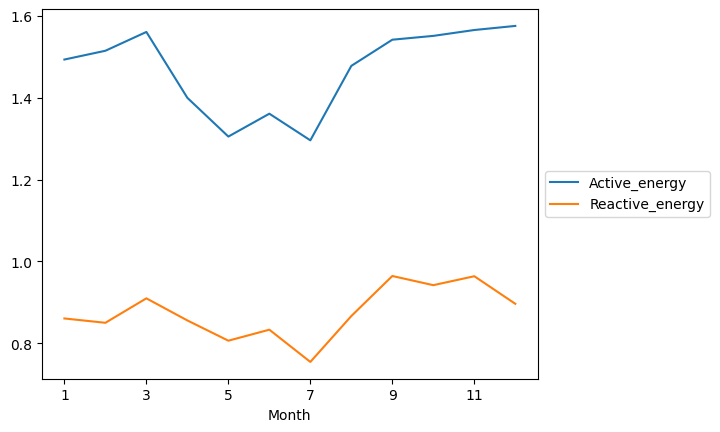

In [27]:
# Comparando la energia activa con la reactiva
pivot_table = df.pivot_table(index="Month",values=['Active_energy','Reactive_energy'],aggfunc={'Active_energy': 'mean', 'Reactive_energy':'mean'})
pivot_table.reindex(["1", "2", "3","4", "5","6","7","8","9","10","11","12"]).plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5))

### Clientes

In [28]:
dfClientes = df[['Clientes','Active_energy']]
dfClientes.groupby(['Clientes'])['Active_energy'].mean().sort_values(ascending=False).head(8)

Clientes
CLIENTE5     4.998897
CLIENTE10    3.545042
CLIENTE2     2.745060
CLIENTE7     2.426154
CLIENTE3     2.341707
CLIENTE1     1.940788
CLIENTE27    1.870751
CLIENTE8     1.579517
Name: Active_energy, dtype: float64

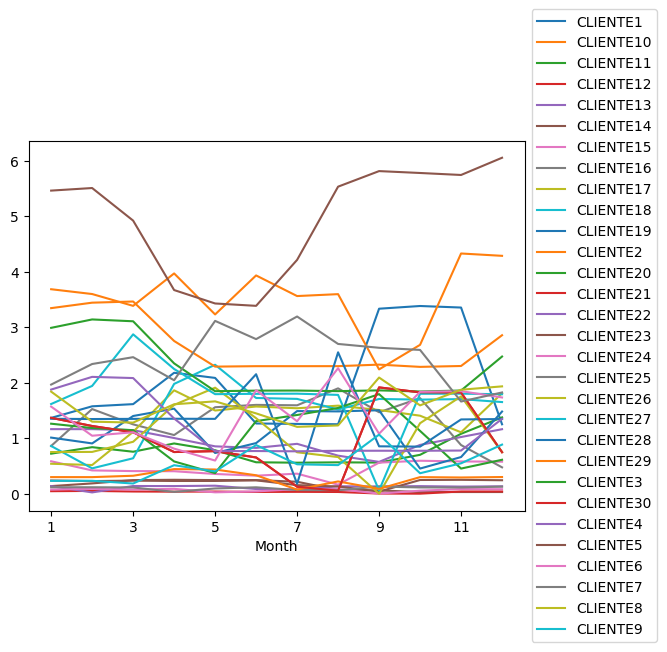

In [29]:
dfC = df.pivot_table(values="Active_energy", index="Month", columns="Clientes")
dfC.reindex(["1", "2", "3","4", "5","6","7","8","9","10","11","12"]).plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

In [30]:
# entendemos comportamiento por mes
dfMonthC = df[['Month','Active_energy','Clientes']]
dfMonthC.sort_values(['Month'], ascending=False).groupby(['Month'])['Active_energy'].mean()
#df.sort_values(['job','count'],ascending=False).groupby('job').head(3)

Month
1     1.493154
10    1.550965
11    1.565312
12    1.575299
2     1.514608
3     1.560561
4     1.399587
5     1.304935
6     1.360839
7     1.295736
8     1.477703
9     1.541621
Name: Active_energy, dtype: float64

### Entendiendo energia activa

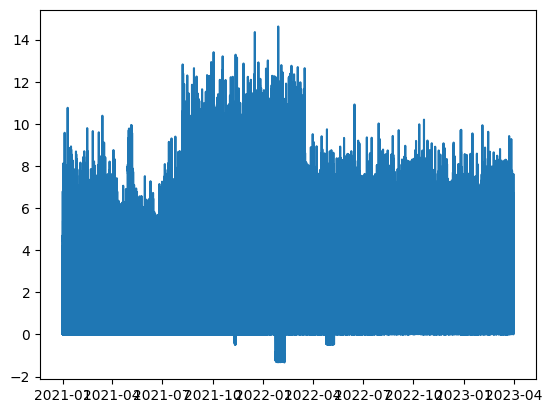

In [31]:
# Entendiendo de la energia activa
datesC = df['Fecha']
EnergiaAc = df['Active_energy']
plt.plot(datesC, EnergiaAc)

<Axes: xlabel='Reactive_energy', ylabel='Active_energy'>

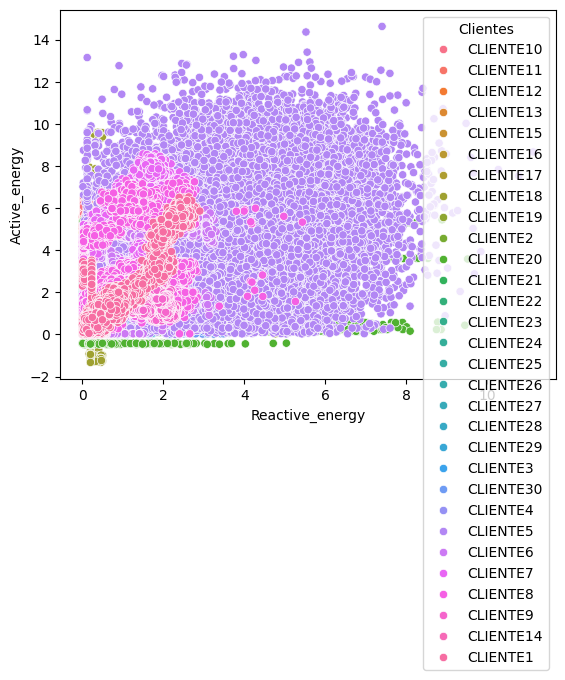

In [32]:
sns.scatterplot(x = 'Reactive_energy', y = 'Active_energy', hue= 'Clientes', data = df)

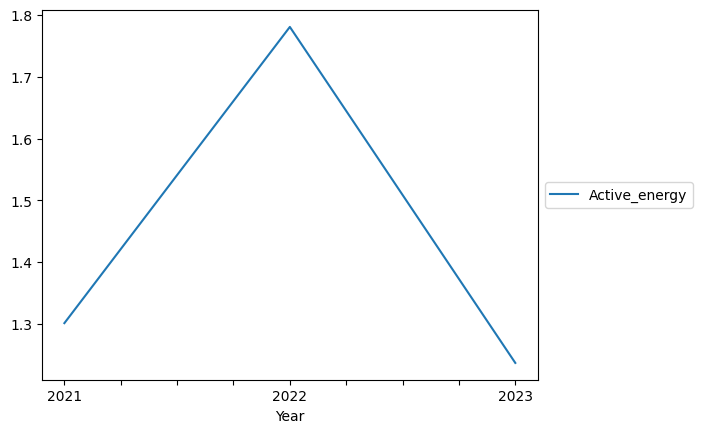

In [33]:
# entendemos comportamiento por ano
dfYear = df.pivot_table(values="Active_energy", index="Year")
dfYear.plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

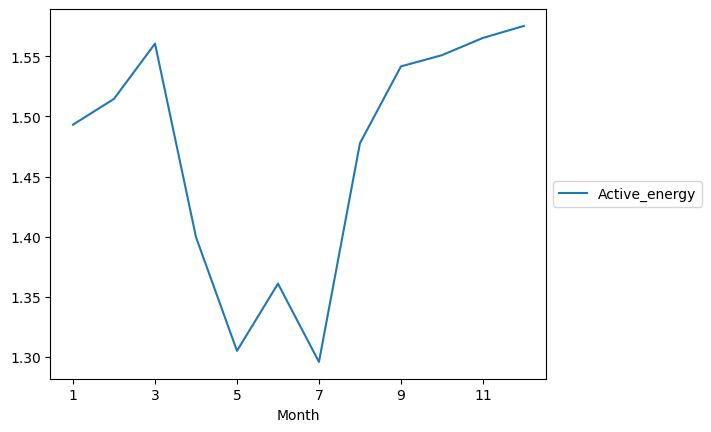

In [34]:
# entendemos comportamiento por mes
dfMonth = df.pivot_table(values="Active_energy", index="Month")
dfMonth.reindex(["1", "2", "3","4", "5","6","7","8","9","10","11","12"]).plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

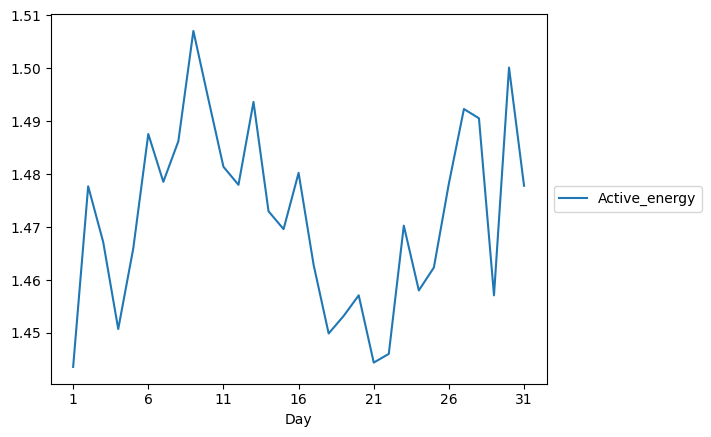

In [35]:
# entendemos comportamiento por dia
dfDay = df.pivot_table(values="Active_energy", index="Day")
dfDay.reindex(["1", "2", "3","4", "5","6","7","8","9","10","11","12","13", "14", "15", "16", "17", "18", "19", "20", "21", "22", "23", "24", "25", "26", "27", "28", "20", "30", "31"]).plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

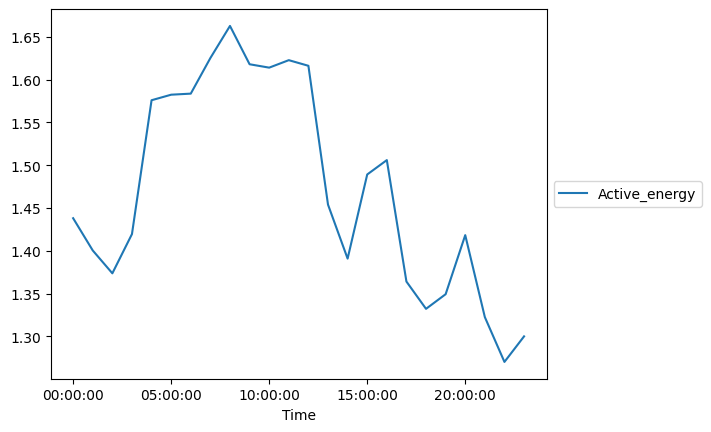

In [36]:
# entendemos comportamiento por hora
dfTime = df.pivot_table(values="Active_energy", index="Time")
dfTime.plot().legend(loc='center left',bbox_to_anchor=(1.0, 0.5));

In [37]:
#Analizamos estadisticamente la deteccion de outliers, para esto creamos una funcion
def find_outliers_IQR(df):
  q1=df.quantile(0.25)
  q3=df.quantile(0.75)
  IQR=q3-q1
  outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]
  return outliers

In [38]:
# llamamos la funcion creada
outliers = find_outliers_IQR(df["Active_energy"])
print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))


number of outliers: 31703
max outlier value: 14.622644283216186
min outlier value: 4.617302617005654


### Independizando el cliente 5

In [39]:
#Crear DataFrame ciente 5 para entender comportamiento
dfCliente5 = df.loc[df['Clientes']=='CLIENTE5']
dfCliente5.shape
dfCliente5.describe()

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Voltaje_Promedio,Energia_Absorbida
count,19681,19681.000000,19681.000000,19681.000000,19681.000000,19681.000000,19681.000000
mean,2022-02-15 00:00:00,4.998897,3.823555,677.911026,678.150518,678.030772,8.822452
min,2021-01-01 00:00:00,0.004968,0.006499,396.813497,434.697528,460.935912,0.369800
25%,2021-07-25 00:00:00,3.248524,2.714658,611.406872,611.517253,618.412545,6.584282
50%,2022-02-15 00:00:00,4.779127,3.798569,649.782373,649.977419,649.552312,8.660627
75%,2022-09-08 00:00:00,6.660707,4.925731,689.443431,690.181461,681.919671,10.913033
max,2023-04-01 00:00:00,14.622644,11.135141,1519.945262,1508.410120,1474.394756,22.023913
std,NaN,2.440656,1.617793,156.027758,155.800896,152.652081,3.128668


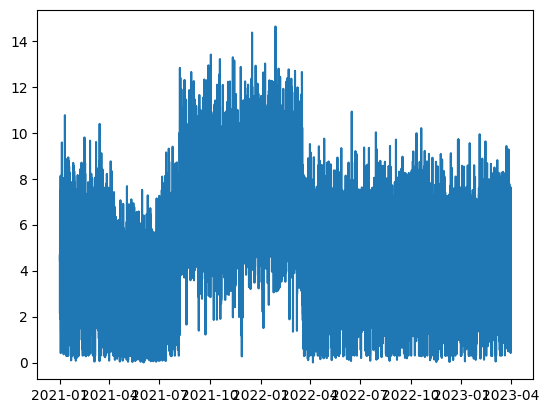

In [40]:
# Entendiendo la energia activa para el cliente 5
datesC5 = dfCliente5['Fecha']
EnergiaAcC5 = dfCliente5['Active_energy']
plt.plot(datesC5, EnergiaAcC5)
plt.show()

<Axes: xlabel='Active_energy', ylabel='Reactive_energy'>

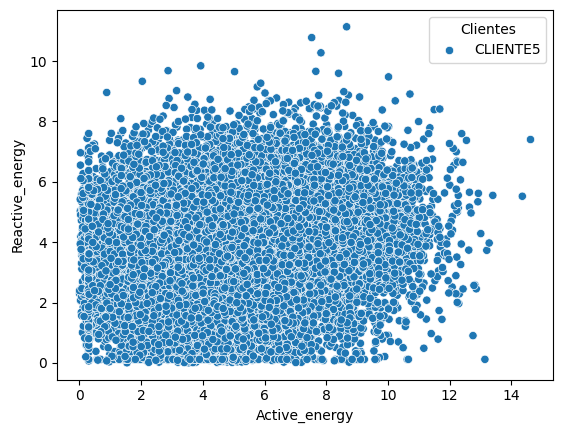

In [41]:
sns.scatterplot(x = 'Active_energy', y = 'Reactive_energy', hue= 'Clientes', data = dfCliente5)

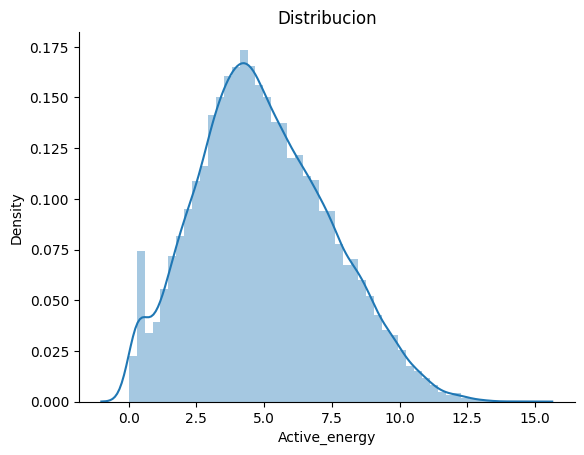

In [42]:
sns.distplot(dfCliente5['Active_energy'])
plt.title("Distribucion")
sns.despine()

In [43]:
#create a box plot
fig = px.box(dfCliente5, y='Active_energy')
fig.show()

In [44]:
fig = px.scatter(x=dfCliente5['Clientes'], y=dfCliente5['Active_energy'])
fig.show()

### Implementamos IQR

In [45]:
#Analizamos estadisticamente la deteccion de outliers, para esto creamos una funcion
def find_outliers_IQR(dfCliente5):
  q1=dfCliente5.quantile(0.25)
  q3=dfCliente5.quantile(0.75)
  IQR=q3-q1
  outliers = dfCliente5[((dfCliente5<(q1-1.5*IQR)) | (dfCliente5>(q3+1.5*IQR)))]
  return outliers

In [46]:
# llamamos la funcion creada
outliers = find_outliers_IQR(dfCliente5["Active_energy"])
print("number of outliers: "+ str(len(outliers)))
print("max outlier value: "+ str(outliers.max()))
print("min outlier value: "+ str(outliers.min()))
outliers

number of outliers: 64
max outlier value: 14.622644283216186
min outlier value: 11.78592931792592


336577    12.820507
336597    12.393231
336642    11.888171
336778    12.297893
336985    11.857016
            ...    
341601    12.694572
341619    11.926254
341713    11.972343
341902    12.643094
341906    12.044382
Name: Active_energy, Length: 64, dtype: float64

In [47]:
outlierss = find_outliers_IQR(dfCliente5[["Active_energy","Reactive_energy"]])
outlierss

,Active_energy,Reactive_energy
331339,NaN,NaN
331340,NaN,NaN
331341,NaN,NaN
331342,NaN,NaN
331343,NaN,NaN
...,...,...
351015,NaN,NaN
351016,NaN,NaN
351017,NaN,NaN
351018,NaN,NaN


## 3. Modelos

In [279]:
# Creamos copia del dataset original
#dfCl = df.copy() #Para cluster
dfCl=df.loc[:, ~df.columns.isin(['Factor_Potencia', 'Year', 'Month'])]
#dfIf = df.copy() #Para Isolation Forest
dfIf = df.loc[:, ~df.columns.isin(['Reactive_energy', 'Voltaje_FA', 'Clientes', 'Sector','Voltaje_Promedio', 'Energia_Absorbida','Voltaje_FC','Factor_Potencia', 'Year', 'Month','Day','Time'])]
dfOl = df.loc[:, ~df.columns.isin(['Reactive_energy', 'Voltaje_FA', 'Clientes', 'Sector','Voltaje_Promedio', 'Energia_Absorbida','Voltaje_FC','Factor_Potencia', 'Year', 'Month','Day','Time'])]
dfCo = df.loc[:, ~df.columns.isin(['Fecha','Time'])] #Correlacion de variables

## 3.1. Correlacion

In [150]:
dfCo

,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Year,Month,Day
0,2.873046,0.508548,1557.057893,1312.106981,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1434.582437,3.381594,2021,1,1
1,2.037791,0.532105,1456.095693,1329.850730,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1392.973211,2.569896,2021,1,1
2,2.358945,0.797515,1226.481132,1301.578937,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1264.030034,3.156459,2021,1,1
3,1.347161,0.472839,1138.403031,1379.538878,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1258.970955,1.820001,2021,1,1
4,2.486699,0.488362,1062.467048,1594.077359,CLIENTE10,Cultivo de Árboles Frutales y Nueces,1328.272204,2.975061,2021,1,1
...,...,...,...,...,...,...,...,...,...,...,...
463420,1.511845,0.642091,473.424130,558.087820,CLIENTE1,Elaboración de cacao y chocolate y de producto...,515.755975,2.153936,2023,3,31
463421,1.395845,0.687746,537.231219,497.526966,CLIENTE1,Elaboración de cacao y chocolate y de producto...,517.379093,2.083592,2023,3,31
463422,0.976828,0.442356,489.302253,519.647463,CLIENTE1,Elaboración de cacao y chocolate y de producto...,504.474858,1.419183,2023,3,31
463423,0.979561,0.451811,460.399523,493.639109,CLIENTE1,Elaboración de cacao y chocolate y de producto...,477.019316,1.431373,2023,3,31


In [151]:
#discretizamos la variable Clientes
dfCo.Clientes=dfCo.Clientes.replace({'CLIENTE1':1,'CLIENTE2':2,'CLIENTE3':3, 'CLIENTE4':4, 'CLIENTE5':5, 'CLIENTE6':6,  'CLIENTE7':7, 'CLIENTE8':8,'CLIENTE9':9, 'CLIENTE10':10, 'CLIENTE11':11, 'CLIENTE12':12, 'CLIENTE13':13, 'CLIENTE14':14, 'CLIENTE15':15, 'CLIENTE16':16, 'CLIENTE17':17, 'CLIENTE18':18, 'CLIENTE19':19, 'CLIENTE20':20, 'CLIENTE21':21, 'CLIENTE22':22, 'CLIENTE23':23,
                                     'CLIENTE24':24, 'CLIENTE25':25, 'CLIENTE26':26, 'CLIENTE27':27, 'CLIENTE28':28, 'CLIENTE29':29, 'CLIENTE30':30})

In [152]:
#discretizamos la variable Sector ECONOMICO
dfCo.Sector=dfCo.Sector.replace({'Elaboración de cacao y chocolate y de productos de confitería':1,'Cultivo de Árboles Frutales y Nueces':2,'Cultivo de otros frutos y nueces de árboles y arbustos':3, 'Cultivo de hortalizas y melones, raíces y tubérculos':4, 'Captación, tratamiento y distribución de agua':5, 'Cultivo de Hortalizas':6, 'Venta al por mayor de metales y minerales metalíferos':7})

In [153]:
corMatrix=dfCo.corr()
corMatrix

,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Year,Month,Day
Active_energy,1.000000,0.641789,-0.240723,-0.239892,-0.345452,-0.352761,-0.243074,0.940620,0.075530,0.011271,-0.000010
Reactive_energy,0.641789,1.000000,-0.150958,-0.158293,-0.201525,-0.208266,-0.156353,0.864006,0.051954,0.020357,-0.001515
Voltaje_FA,-0.240723,-0.150958,1.000000,0.954814,0.336556,0.347968,0.988937,-0.224864,-0.014690,0.003231,0.005915
Voltaje_FC,-0.239892,-0.158293,0.954814,1.000000,0.320904,0.336323,0.988337,-0.227565,-0.017897,0.003939,0.004279
Clientes,-0.345452,-0.201525,0.336556,0.320904,1.000000,0.978313,0.332611,-0.316005,-0.252695,-0.013766,-0.008936
Sector,-0.352761,-0.208266,0.347968,0.336323,0.978313,1.000000,0.346154,-0.323788,-0.242045,-0.009939,-0.008903
Voltaje_Promedio,-0.243074,-0.156353,0.988937,0.988337,0.332611,0.346154,1.000000,-0.228796,-0.016460,0.003621,0.005167
Energia_Absorbida,0.940620,0.864006,-0.224864,-0.227565,-0.316005,-0.323788,-0.228796,1.000000,0.072585,0.016410,-0.000678
Year,0.075530,0.051954,-0.014690,-0.017897,-0.252695,-0.242045,-0.016460,0.072585,1.000000,-0.271818,-0.017047
Month,0.011271,0.020357,0.003231,0.003939,-0.013766,-0.009939,0.003621,0.016410,-0.271818,1.000000,0.019361


<Axes: >

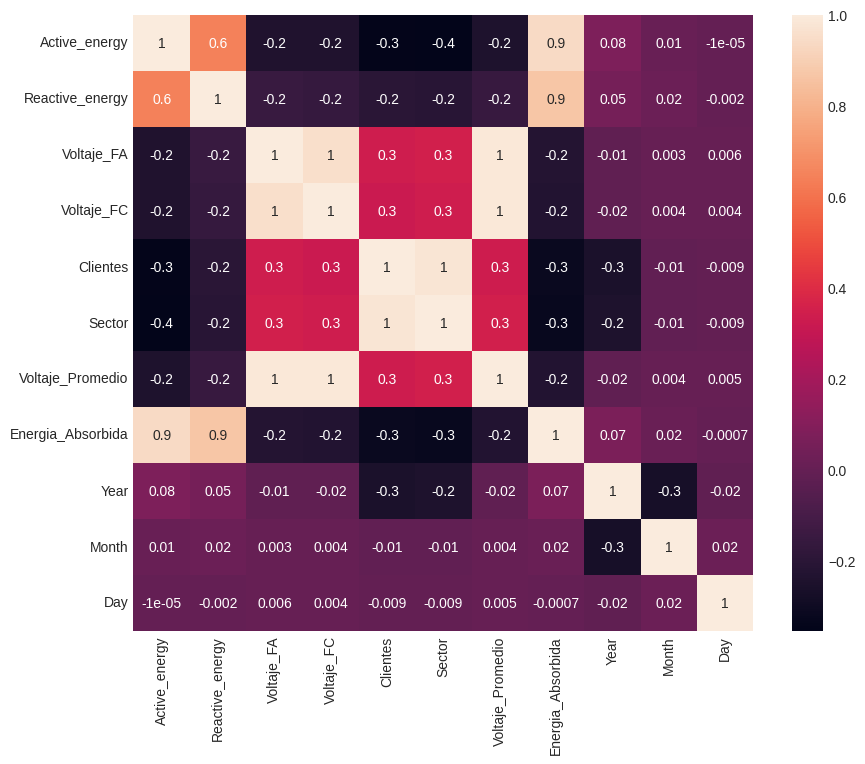

In [154]:
#Importe nuevamente las librias de Seaborn y Matplotlib en caso de que no estén importadas

#Sentencia para ajustar la visualización y tamaño del gráfico
f, ax = plt.subplots(figsize=(10, 8))
#HeatMap de Seaborn, annot:muestra valores, fmt:decimales, ax:visializacion
sns.heatmap(corMatrix,annot = True,fmt='.1g',ax=ax)

## 3.2. K-means

In [155]:
#discretizamos la variable Clientes
dfCl.Clientes=dfCl.Clientes.replace({'CLIENTE1':1,'CLIENTE2':2,'CLIENTE3':3, 'CLIENTE4':4, 'CLIENTE5':5, 'CLIENTE6':6,  'CLIENTE7':7, 'CLIENTE8':8,'CLIENTE9':9, 'CLIENTE10':10, 'CLIENTE11':11, 'CLIENTE12':12, 'CLIENTE13':13, 'CLIENTE14':14, 'CLIENTE15':15, 'CLIENTE16':16, 'CLIENTE17':17, 'CLIENTE18':18, 'CLIENTE19':19, 'CLIENTE20':20, 'CLIENTE21':21, 'CLIENTE22':22, 'CLIENTE23':23,
                                     'CLIENTE24':24, 'CLIENTE25':25, 'CLIENTE26':26, 'CLIENTE27':27, 'CLIENTE28':28, 'CLIENTE29':29, 'CLIENTE30':30})

In [156]:
#discretizamos la variable Sector ECONOMICO
dfCl.Sector=dfCl.Sector.replace({'Elaboración de cacao y chocolate y de productos de confitería':1,'Cultivo de Árboles Frutales y Nueces':2,'Cultivo de otros frutos y nueces de árboles y arbustos':3, 'Cultivo de hortalizas y melones, raíces y tubérculos':4, 'Captación, tratamiento y distribución de agua':5, 'Cultivo de Hortalizas':6, 'Venta al por mayor de metales y minerales metalíferos':7})

In [157]:
# Eliminamos columna Fecha
dfCl = dfCl.drop(['Fecha','Time'], axis=1)

In [158]:
#mètodo del codo es un evento grafico que permite ver el punto de inflecciòn a partir de las distancias
ks=range(2,10)
inertias=[]

for k in ks:
  #creamos el modelo
  modelo=KMeans(n_clusters=k)
  modelo.fit(dfCl)
  inertias.append(modelo.inertia_)

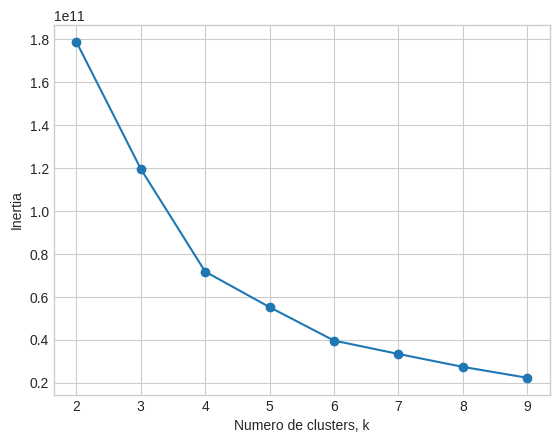

In [159]:
#grafiquemos el metodo del codo
plt.plot(ks,inertias,'-o')
plt.xlabel('Numero de clusters, k')
plt.ylabel('Inertia')
plt.xticks(ks)
plt.show()
#en el punto aproximado donde hay quiere un codo, quiere decir que a partir de allì es muy suave

In [160]:
#numero de centroides
modelo=KMeans(n_clusters=4,max_iter=300, tol=0.0001, n_init=10, verbose=0, random_state=None, algorithm='auto')
modelo.fit(dfCl)

KMeans(algorithm='auto', n_clusters=4, n_init=10)

In [162]:
centroides=pd.DataFrame(modelo.cluster_centers_,columns=dfCl.columns.values)
centroides.round(0)

,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Day
0,2.0,1.0,3149.0,3107.0,8.0,2.0,3128.0,2.0,16.0
1,2.0,1.0,471.0,531.0,6.0,2.0,501.0,4.0,16.0
2,1.0,1.0,1134.0,1136.0,19.0,5.0,1135.0,2.0,16.0
3,1.0,1.0,2011.0,2015.0,17.0,4.0,2013.0,2.0,16.0


In [163]:
#asignemos un cluster a cada registros
dfCl['cluster']=modelo.predict(dfCl)
dfCl.head()

,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Clientes,Sector,Voltaje_Promedio,Energia_Absorbida,Day,cluster
0,2.873046,0.508548,1557.057893,1312.106981,10,2,1434.582437,3.381594,1,2
1,2.037791,0.532105,1456.095693,1329.850730,10,2,1392.973211,2.569896,1,2
2,2.358945,0.797515,1226.481132,1301.578937,10,2,1264.030034,3.156459,1,2
3,1.347161,0.472839,1138.403031,1379.538878,10,2,1258.970955,1.820001,1,2
4,2.486699,0.488362,1062.467048,1594.077359,10,2,1328.272204,2.975061,1,2


In [164]:
#perfilamiento
print(dfCl.cluster.value_counts())
print(centroides.round(0))

cluster
3    221571
1    134683
2     93452
0     13719
Name: count, dtype: int64
   Active_energy  Reactive_energy  Voltaje_FA  Voltaje_FC  Clientes  Sector  \
0            2.0              1.0      3149.0      3107.0       8.0     2.0   
1            2.0              1.0       471.0       531.0       6.0     2.0   
2            1.0              1.0      1134.0      1136.0      19.0     5.0   
3            1.0              1.0      2011.0      2015.0      17.0     4.0   

   Voltaje_Promedio  Energia_Absorbida   Day  
0            3128.0                2.0  16.0  
1             501.0                4.0  16.0  
2            1135.0                2.0  16.0  
3            2013.0                2.0  16.0  


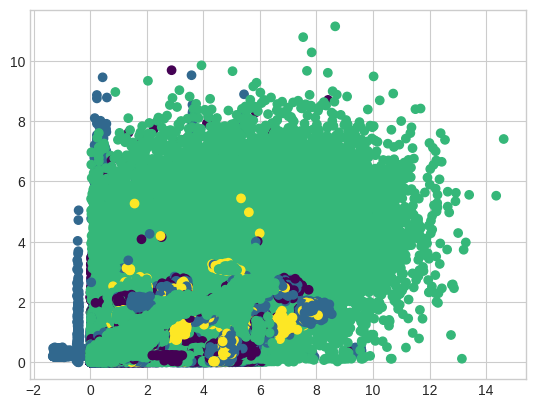

In [165]:
labels = modelo.fit_predict(dfCl)
plt.scatter(dfCl.iloc[:, 0].values, dfCl.iloc[:, 1].values, c=labels, cmap='viridis');

In [167]:
#medir el desempeño del modelo del modelo k-means con
#indice de compactabilidad (davies and boudin index)
#entre mas cercano a 1 mejor, el valor oscila entre -1 y 1.
dv=metrics.davies_bouldin_score(dfCl.drop('cluster',axis=1),dfCl.cluster)
#silueta=metrics.silhouette_score(dfCl.drop('cluster',axis=1),dfCl.cluster)
#silueta=metrics.silhouette_score(dfCl, modelo.predict(dfCl))
print(f'indice de Davies and Bouldin={dv}')
#print(f'indice de silueta={silueta}')


indice de Davies and Bouldin=0.5442926578877509


## 3.3. Isolation forest

In [242]:
dfIf['Anomalo'] = np.where(dfIf['Active_energy']>4.73,1,0)

Text(0, 0.5, 'Cantidad')

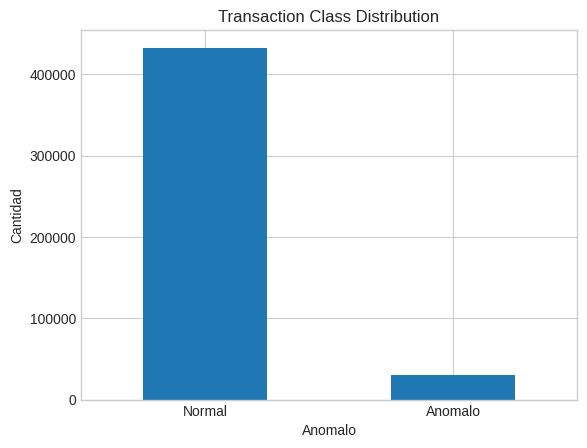

In [244]:
LABELS = ["Normal","Anomalo"]
count_classes = pd.value_counts(dfIf['Anomalo'], sort = True)
count_classes.plot(kind = 'bar', rot=0)
plt.title("Transaction Class Distribution")
plt.xticks(range(2), LABELS)
plt.xlabel("Anomalo")
plt.ylabel("Cantidad")

In [245]:
#validación de los valores anomalos
Anomalo = dfIf['Anomalo'].value_counts().to_frame()
Anomalo

,count
Anomalo,
0,432872
1,30553


In [246]:
dfIf = dfIf.set_index(pd.DatetimeIndex(dfIf['Fecha']))

In [248]:
# Eliminamos columna Fecha y time
dfIf = dfIf.drop(['Fecha'], axis=1)

In [249]:
x=dfIf.drop('Anomalo', axis=1)#variables predictoras
y= dfIf.Anomalo#Variables objetivo

In [250]:
# Split the data into training and testing sets
xtrain, xTest, ytrain, yTest = train_test_split(x,y,test_size=0.3,random_state=1)
model = IsolationForest(n_estimators=10, max_samples='auto', contamination=float(.04), max_features=1.0, bootstrap=False, n_jobs=-1, random_state=42,verbose=0)
model.fit(xtrain)

IsolationForest(contamination=0.04, n_estimators=10, n_jobs=-1, random_state=42)

In [251]:
# Make predictions on the test set
ypred = model.predict(xTest)

In [252]:
fig = go.Figure(data=[go.Scatter(x=dfIf.index,y=dfIf['Active_energy'])])
iplot(fig)

[<Axes: >]

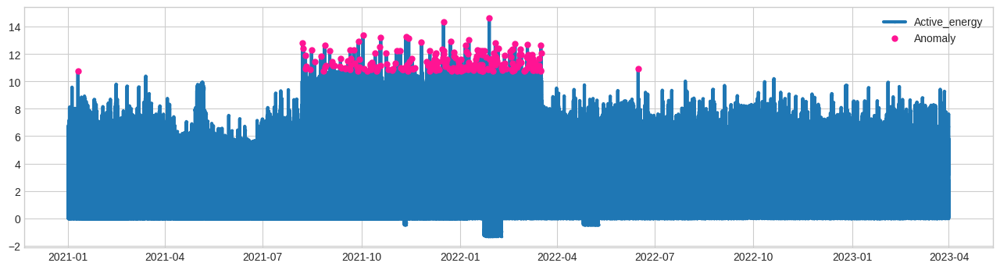

In [253]:
#IQR Methodology using the ADTK Library
iqr_ad = InterQuartileRangeAD(c=5.0)
anomalies = iqr_ad.fit_detect(dfIf['Active_energy'])
plot(dfIf['Active_energy'], anomaly=anomalies, ts_linewidth=3, ts_markersize=3, anomaly_markersize=5, anomaly_color='deeppink', anomaly_tag="marker")

In [254]:
anomaly_values = dfIf.iloc[np.where(ypred == -1)]

In [255]:
print("Matriz de confusión: \n", confusion_matrix(yTest, ypred))

Matriz de confusión: 
 [[     0      0      0]
 [     0      0 129929]
 [  5270      0   3829]]


In [256]:
# Evaluate the model
print(classification_report(yTest, ypred))

              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           0       0.00      0.00      0.00    129929
           1       0.03      0.42      0.05      9099

    accuracy                           0.03    139028
   macro avg       0.01      0.14      0.02    139028
weighted avg       0.00      0.03      0.00    139028



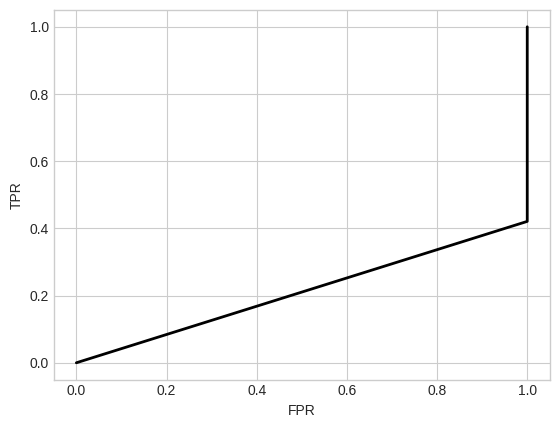

In [257]:
#Curva ROC
fpr, tpr, thresholds = metrics.roc_curve(yTest,ypred)
plt.plot(fpr, tpr, 'k-', lw=2)
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.show()

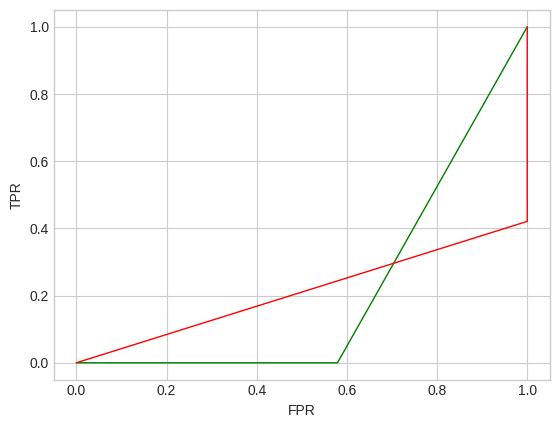

In [258]:
fpr_wrong, tpr_wrong, _ = metrics.roc_curve(yTest, ypred)
fpr_correct, tpr_correct, _ = metrics.roc_curve(yTest, -ypred, pos_label=0)

plt.plot(fpr_correct, tpr_correct, 'green', lw=1)
plt.plot(fpr_wrong, tpr_wrong, 'red', lw=1)
plt.xlabel('FPR')
plt.ylabel('TPR')
plt.show()

## 3.3. Local Outlier

In [273]:
#discretizamos la variable Clientes
dfOl.Clientes=dfOl.Clientes.replace({'CLIENTE1':1,'CLIENTE2':2,'CLIENTE3':3, 'CLIENTE4':4, 'CLIENTE5':5, 'CLIENTE6':6,  'CLIENTE7':7, 'CLIENTE8':8,'CLIENTE9':9, 'CLIENTE10':10, 'CLIENTE11':11, 'CLIENTE12':12, 'CLIENTE13':13, 'CLIENTE14':14, 'CLIENTE15':15, 'CLIENTE16':16, 'CLIENTE17':17, 'CLIENTE18':18, 'CLIENTE19':19, 'CLIENTE20':20, 'CLIENTE21':21, 'CLIENTE22':22, 'CLIENTE23':23,
                                     'CLIENTE24':24, 'CLIENTE25':25, 'CLIENTE26':26, 'CLIENTE27':27, 'CLIENTE28':28, 'CLIENTE29':29, 'CLIENTE30':30})

In [274]:
#discretizamos la variable Sector ECONOMICO
dfOl.Sector=dfOl.Sector.replace({'Elaboración de cacao y chocolate y de productos de confitería':1,'Cultivo de Árboles Frutales y Nueces':2,'Cultivo de otros frutos y nueces de árboles y arbustos':3, 'Cultivo de hortalizas y melones, raíces y tubérculos':4, 'Captación, tratamiento y distribución de agua':5, 'Cultivo de Hortalizas':6, 'Venta al por mayor de metales y minerales metalíferos':7})

In [280]:
dfOl['Anomalo'] = np.where(dfOl['Active_energy']>4.13,1,0)

In [289]:
xOl = dfOl.drop('Anomalo', axis=1)#variables predictoras
yOl = dfOl.Anomalo#Variables objetivo

In [284]:
dfOl = dfOl.set_index(pd.DatetimeIndex(dfOl['Fecha']))

In [285]:
# Eliminamos columna Fecha
dfOl = dfOl.drop(['Fecha'], axis=1)

In [290]:
dfOl

,Active_energy,Anomalo
Fecha,,
2021-01-01 00:00:00,2.873046,0
2021-01-01 01:00:00,2.037791,0
2021-01-01 02:00:00,2.358945,0
2021-01-01 03:00:00,1.347161,0
2021-01-01 04:00:00,2.486699,0
...,...,...
2023-03-31 20:00:00,1.511845,0
2023-03-31 21:00:00,1.395845,0
2023-03-31 22:00:00,0.976828,0


In [291]:
# Split the data into training and testing sets
xtrain, xTest, ytrain, yTest = train_test_split(xOl,yOl,test_size=0.3,random_state=42)

# Standardize the dataset
scaler = StandardScaler()
#data = scaler.fit_transform(xTest)

In [294]:
lof = LocalOutlierFactor(n_neighbors=20, algorithm='auto', leaf_size=30, metric='minkowski', p=2, metric_params=None, contamination='auto')
#ypredOl = lof.fit_predict(data)